# HW 1



## E1 - Parabolic motion 

Our system is modeladed by the stage $\mathbf{x}_s$, that cotains the position and its velocities. using $\mathbf{\ddot{x}}$ the current force applied to the ball, we can compute its integration by euler integration $\mathbf{{x}}_{s(t)}$.

$
\begin{eqnarray}
    \mathbf{\ddot{x}} &=& -m \, g \,
    \left [
        \begin{array}
            00 \\
            0 \\
            1
        \end{array} 
    \right ] \\
    \mathbf{\dot{x}}_s &=& 
    \left [ 
    \begin{array}
    \centering
            \dot{\mathbf{x}}_0 + \dot{{\mathbf{x}}} \\
             \ddot{\mathbf{x}}
    \end{array}
    \right ] \\    
    \mathbf{{x}}_{s(t)} &=& \mathbf{{x}}_{s(t-1)} + \mathbf{\dot{x}}_s \, \Delta t
\end{eqnarray}
$

In [1]:
%pylab inline

import numpy as np
from scipy.integrate import odeint
import matplotlib.pyplot as plt

import matplotlib.pyplot as plt
# from matplotlib import animation
from JSAnimation import IPython_display    
from IPython.display import HTML
    
# import matplotlib
# matplotlib.rcParams['animation.embed_limit'] = 2**128
matplotlib.rcParams.update({'font.size': 22})

def Rotz(Θ):
    R = array([[cos(Θ), -sin(Θ),0], [sin(Θ), cos(Θ),0],[0,0,1]])
    return R

def Roty(Θ):
    R = array([[cos(Θ), sin(Θ)], [-sin(Θ), cos(Θ)]])
    return R


def plotsim(x_log):
    x_log = array(x_log)
#     F_log = array(F_log)
#     print(len(x_log[:,0]))
    # subplot(2,1,1)
    plt.figure(figsize=(10,5))
    plot(x_log[:,0], x_log[:,1])
    xlabel('x')
    ylabel('z')
    plt.tight_layout()
    fig = plt.figure(figsize=(10,5))
    subplot(3,2,1)
    plot(time[:],x_log[:-1,0])
    xlabel('t')
    ylabel('x')
    subplot(3,2,2)
    plot(time[:],x_log[:-1,1])
    xlabel('t')
    ylabel('z')
    subplot(3,2,3)
    plot(time[:],x_log[:-1,2])
    xlabel('t')
    ylabel('dx')
    subplot(3,2,4)
    plot(time[:],x_log[:-1,3])
    xlabel('t')
    ylabel('dz')    
    plt.tight_layout()
    plt.show()

Populating the interactive namespace from numpy and matplotlib


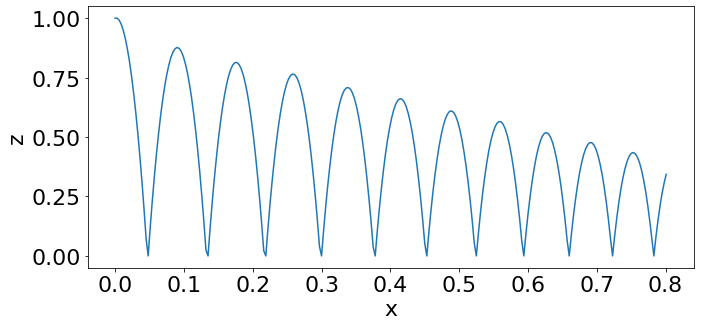

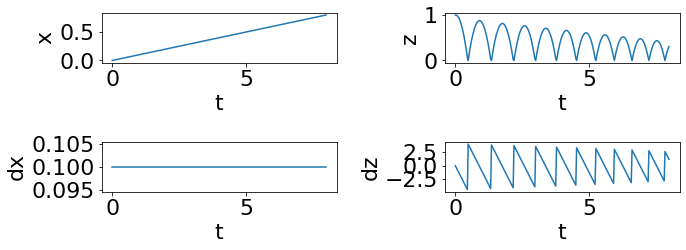

In [2]:
def simulate(x, t):
    
    dx = concatenate((x[2:4], -g*array([0., 1])), axis=None)   
    x += dx * Δt
    
    if x[1] < 0 :
        x[1]=0.
        x[3] = -x[3]*0.85
    
    return x


tf = 8
Δt = 0.03    # Time step
time = linspace(0.,tf, int(tf / Δt) + 1)  # Time interval
g = 9.8
m = 1.

# Initial conditions

x_0 = array([0., 1.])
dx_0 = array([0.1, 0.])
ddx_0 = - m * g * array([0., 1])


x = concatenate((x_0, dx_0/m), axis=None)


x_log = [copy(x)]


for t in time:
    x = simulate(x, t)
    x_log.append(copy(x))
    
x_log = array(x_log)
plotsim(x_log)



267


Animation size has reached 20991080 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


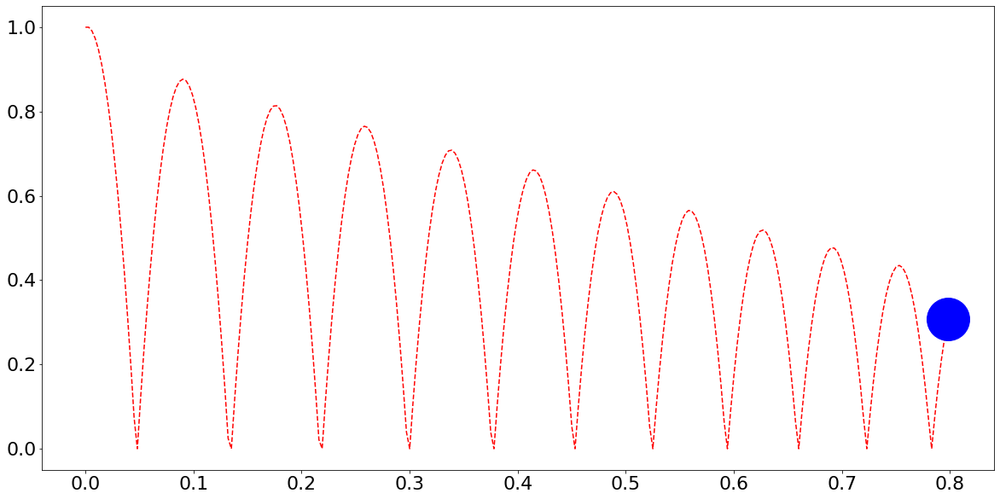

In [3]:
fig, ax = plt.subplots(figsize=(20,10))
x_log = array(x_log)

def animate(t):
    ax.clear()
    
    # Path
#     plot(x_log[:,0], x_log[:,1])

    plot(x_log[:,0], x_log[:,1], 'r--')
    
    # Initial conditions
    plot(x_log[t,0], x_log[t,1], 'bo', markersize=50)
#     plt.quiver()
    
    
print(len(time))

anim = matplotlib.animation.FuncAnimation(fig, animate, frames=len(time), interval=30)

# anim.save('HW1_E2.gif', writer='imagemagick')

HTML(anim.to_jshtml())


## E2 - Motion with constraints and parabolic motion


Our system is modeladed by the stage $\mathbf{x}_s$, that cotains the position and its velocities. using $\mathbf{\ddot{x}}$ the current force applied to the ball, we can compute its integration by euler integration $\mathbf{{x}}_{s(t)}$.

$
\begin{eqnarray}
    \mathbf{\ddot{x}} &=& -m \, g \,
    \left [
        \begin{array}
            00 \\
            0 \\
            1
        \end{array} 
    \right ] \\
    \mathbf{\dot{x}}_s &=& 
    \left [ 
    \begin{array}
            \dot{\dot{\mathbf{x}}} \\
            \ddot{\mathbf{x}}
    \end{array}
    \right ] \\    
    \mathbf{{x}}_{s(t)} &=& \mathbf{{x}}_{s(t-1)} + \mathbf{\dot{x}}_s \, \Delta t
\end{eqnarray}
$

1002
1001


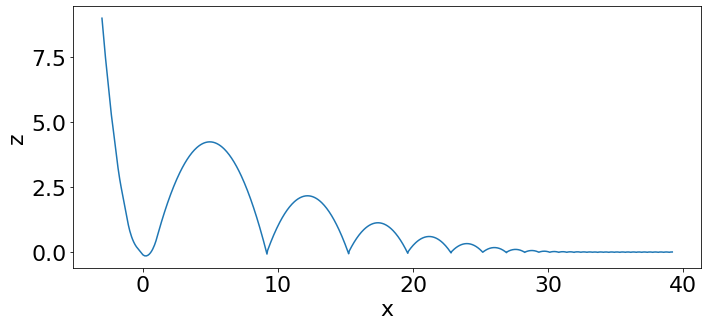

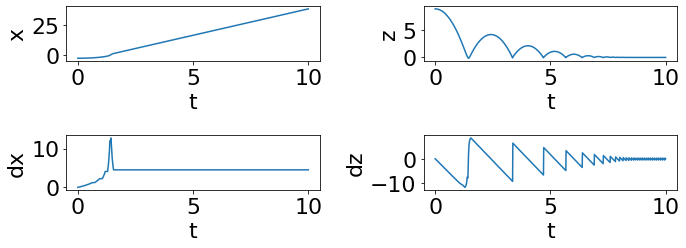

In [4]:
def Nn(x):
    R = sqrt((1. + 2.*x[0]**2.)**3.)/2.
    ug = array([0., -1.])
#     ut = array([1, 2*x[0]])/sqrt(4*x[0]**2 + 1)
    un = array([-2*x[0], 1])/sqrt(4*x[0]**2 + 1)
    V2 = (x[2]**2+x[3]**2)  
    N = (V2/R)*m + m*g*(ug.dot(-un))
    if x[0]**2 < x[1]:
        N = 0
    
    return N, un, ug

def simulate(Δt, x):
         
    if x[0] < 1:
        N, un, ug = Nn(x)    
        Ftotal = N*un + m*g*ug
        
    elif x[0] >= 1:
        N=0
        Ftotal = -g*array([0., 1.])
        if x[1] <= 0 :
            x[1] = 0.
            x[3] = -x[3]*0.7

    dx = concatenate((x[2:4], Ftotal/m), axis=None)  
    x += dx * Δt
    
    return [x, Ftotal, N]


tf = 10.
Δt = 0.01    # Time step
time = linspace(0.,tf, int(tf / Δt) + 1)  # Time interval
g = 9.8
m = 1.

dx_0 = array([0., 0.])
x_0 = array([-3., 9.])

x = concatenate((x_0, dx_0/m), axis=None)
F = array([0., 0.])

x_log = [copy(x)]
F_log = [copy(F)]
N_log = [copy(0)]
for t in time:
    [x, F, N] = simulate(Δt, x)
    x_log.append(copy(x))
    F_log.append(copy(F))
    N_log.append(copy(N))

print(len(x_log))
print(len(time))
plotsim(x_log)

In [ ]:

fig, ax = plt.subplots(figsize=(20,10))
x_log = array(x_log)

def animate(t):
    ax.clear()
    
    # Path
#     plot(x_log[:,0], x_log[:,1])
    
    plot(x_log[:180,0]+x_log[:180,0]*0.3, x_log[:180,1]-0.5, 'y')
    plot(x_log[:,0], x_log[:,1], 'r--')
    plot(x_log[:,0], 0*x_log[:,1]-0.6, 'y')
    
    # Initial conditions
    plot(x_log[t,0], x_log[t,1], 'bo', markersize=50)
#     plt.quiver()
    
    
print(len(time))

anim = matplotlib.animation.FuncAnimation(fig, animate, frames=len(time), interval=20)

# HTML(anim.to_jshtml())
display(HTML(anim.to_jshtml()))

1001
